In [5]:
import os
import glob
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
# import plotly #allows interactive plotting
# import contextily as ctx # back ground maps
# import rasterio
import shapely

In [6]:
doc_dir = os.getcwd()
while os.path.basename(doc_dir) != 'Documents':
    doc_dir = os.path.dirname(doc_dir)
# dir of all gwfm data
gwfm_dir = os.path.dirname(doc_dir)+'/Box/research_cosumnes/GWFlowModel'
# dir of stream level data for seepage study
lvl_dir = gwfm_dir + '/Stream_seepage/Stream_level_data'


# Quick Map of Loggers

<AxesSubplot:>

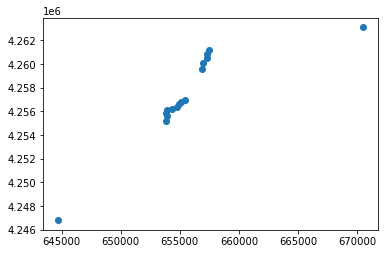

In [8]:
df = pd.read_csv(lvl_dir+'/instream_sensor_latlong.csv')
rm_sp = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.Longitude,df.Latitude))
rm_sp.crs = 'epsg:4326'
rm_sp = rm_sp.to_crs('epsg:32610')

fig, ax =plt.subplots(figsize=(6,6))
rm_sp.plot(ax=ax)
# USGS. USImagery, USImageryTopo, USTopo; Esri. WorldImagery, WorldTopoMap
# ctx.add_basemap(ax=ax, source=ctx.providers.Esri.WorldImagery, crs='epsg:26910', attribution=False)


# Import data files from WY2020

Read in first streamlevel file to create structure for dataframe

In [9]:
def clean_strm_lvl(filename):
    """ cleaning funtioning for levelogger data/column headers where data starts in the 14th row
    Uses file name to rename level column"""
    strmlvl = pd.read_csv(filename,skiprows=13, usecols = ['Date','Time', 'LEVEL'])
    strmlvl['dt'] = pd.to_datetime(strmlvl.Date+' '+strmlvl.Time)
    strmlvl = strmlvl.set_index('dt').drop(['Date','Time'],axis = 1)
    site_nam = str.split(os.path.basename(filename),'_')[0]
    strmlvl = strmlvl.rename(columns = {'LEVEL':site_nam})
    strmlvl = strmlvl.sort_index()
    strmlvl = strmlvl.resample('15min').mean()
    return(strmlvl)


Read in stream level data from WY2020 and join all sites together by time

In [10]:
files = glob.glob(lvl_dir+'/stream_level_2020_11_19/*.csv')

streamlevel_2020 = clean_strm_lvl(files[0])
for i in np.arange(1,len(files)):
    temp = clean_strm_lvl(files[i])
    streamlevel_2020 = streamlevel_2020.join(temp, on = 'dt', how = 'inner')
#     streamlevel = pd.merge(streamlevel, temp, on = 'dt', how = 'inner')

UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb0 in position 155: invalid start byte

Read in stream level data from WY2021 and join all sites together by time

In [37]:
files = glob.glob(lvl_dir+'/stream_level_2021_09/*.csv')
streamlevel_2021 = clean_strm_lvl(files[0])
for i in np.arange(1,len(files)):
    temp = clean_strm_lvl(files[i])
    streamlevel_2021 = streamlevel_2021.join(temp, on = 'dt', how = 'inner')
#     streamlevel = pd.merge(streamlevel, temp, on = 'dt', how = 'inner')

UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb0 in position 155: invalid start byte

Join data from WY2021 and WY2020 by site
For WY2021 *RM8* was stolen and *RM3* wouldn't connect to the computer.

In [64]:
streamlevel = streamlevel_2020.append(streamlevel_2021)

In [68]:
# save joined streamlevel data to csv for easier use
streamlevel.to_csv(lvl_dir+'/Stream_level_m_WY20_WY21.csv')

In [66]:
# RM: 2,4,6,8 need to have 9.5m subtracted, some leveloggers have this setting others don't
if streamlevel.iloc[0,:].loc[['RM2','RM4','RM6','RM8']].mean()>9.5:
    streamlevel.loc[:,['RM2','RM4','RM6','RM8']] = streamlevel.loc[:,['RM2','RM4','RM6','RM8']]-9.5


In [115]:
# pd.options.plotting.backend = "plotly"
# # pd.options.plotting.backend = "matplotlib"

# # fig, ax = plt.subplots(figsize=(10,10))
# fig = streamlevel.plot()
# fig.show() # plotly
# fig # mpl